In [0]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
import os
os.chdir("/content/drive/My Drive/fast-neural")
os.getcwd()

'/content/drive/My Drive/fast-neural'

In [0]:
import torchvision.models as models
import copy
import os
from google.colab import drive
import cv2
from google.colab.patches import cv2_imshow
from torchvision import datasets, transforms
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from PIL import Image
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
from google.api_core.exceptions import InvalidArgument

# fast nerual transfer
# content and style loss

In [0]:
class Normal(nn.Module):
    def __init__(self):
        super(Normal, self).__init__()
        self.mean = torch.tensor([0.485, 0.456, 0.406]).to(device).view(-1, 1, 1)
        self.std = torch.tensor([0.229, 0.224, 0.225]).to(device).view(-1, 1, 1)

    def forward(self, img):
        # normalize img
        return (img - self.mean) / self.std
 
class LossOfContent(nn.Module):
  def __init__(self,goal):
      super(LossOfContent,self).__init__()
      self.goal_feature = goal.detach()
      
  def forward(self,items):
      self.loss = F.mse_loss(items, self.goal_feature)
      return items

class LossOfStyle(nn.Module):

  def __init__(self, target_feature):
      super(LossOfStyle, self).__init__()
      self.target = gram_matrix(target_feature).detach()

  def forward(self, input):
      G = gram_matrix(input)
      self.loss = F.mse_loss(G, self.target)
      return input

def gram_matrix(inputs):
  in_n, in_h, in_w, in_c =inputs.size()
  new_inputs_curr = inputs.view(in_n, in_h ,in_c * in_w)
  gram_matrix_result = torch.bmm(new_inputs_curr,new_inputs_curr.transpose(1,2))
  all_G = gram_matrix_result.div(in_n * in_h * in_w * in_c)
  return all_G
  

def get_model(cnn, style_img, content_img):
  cnn = copy.deepcopy(cnn)
  Normal1 = Normal().to(device)
  content_losses = []
  style_losses = []
  model = nn.Sequential(Normal1)
  for index, layer in enumerate(cnn.children()):
      name = '{}'.format(index)
      model.add_module(name, layer)
      if index in [3, 8, 17, 22, 26, 35]:
          target_feature = model(style_img)
          style_loss = LossOfStyle(target_feature)
          style_losses.append(style_loss)
          model.add_module("{}_{}".format(index,"style"), style_loss)
          if index == 8:
              target_content = model(content_img)
              content_loss = LossOfContent(target_content)
              content_losses.append(content_loss)
              model.add_module("{}_{}".format(index,"content"), content_loss)
          if name == 35:
              break
  return model, style_losses, content_losses

# transformer

In [0]:
# This part is an existing implemantion of transformerNerwork

# class TransformerNetwork(nn.Module):
#     """Feedforward Transformation Network without Tanh
#     reference: https://arxiv.org/abs/1603.08155 
#     exact architecture: https://cs.stanford.edu/people/jcjohns/papers/fast-style/fast-style-supp.pdf
#     """
#     def __init__(self):
#         super(TransformerNetwork, self).__init__()
#         self.ConvBlock = nn.Sequential(
#             ConvLayer(3, 32, 9, 1),
#             nn.ReLU(),
#             ConvLayer(32, 64, 3, 2),
#             nn.ReLU(),
#             ConvLayer(64, 128, 3, 2),
#             nn.ReLU()
#         )
#         self.ResidualBlock = nn.Sequential(
#             ResidualLayer(128, 3), 
#             ResidualLayer(128, 3), 
#             ResidualLayer(128, 3), 
#             ResidualLayer(128, 3), 
#             ResidualLayer(128, 3)
#         )
#         self.DeconvBlock = nn.Sequential(
#             DeconvLayer(128, 64, 3, 2, 1),
#             nn.ReLU(),
#             DeconvLayer(64, 32, 3, 2, 1),
#             nn.ReLU(),
#             ConvLayer(32, 3, 9, 1, norm="None")
#         )

#     def forward(self, x):
#         x = self.ConvBlock(x)
#         x = self.ResidualBlock(x)
#         out = self.DeconvBlock(x)
#         return out

# class ConvLayer(nn.Module):
#     def __init__(self, in_channels, out_channels, kernel_size, stride, norm="instance"):
#         super(ConvLayer, self).__init__()
#         # Padding Layers
#         padding_size = kernel_size // 2
#         self.reflection_pad = nn.ReflectionPad2d(padding_size)

#         # Convolution Layer
#         self.conv_layer = nn.Conv2d(in_channels, out_channels, kernel_size, stride)

#         # Normalization Layers
#         self.norm_type = norm
#         if (norm=="instance"):
#             self.norm_layer = nn.InstanceNorm2d(out_channels, affine=True)
#         elif (norm=="batch"):
#             self.norm_layer = nn.BatchNorm2d(out_channels, affine=True)

#     def forward(self, x):
#         x = self.reflection_pad(x)
#         x = self.conv_layer(x)
#         if (self.norm_type=="None"):
#             out = x
#         else:
#             out = self.norm_layer(x)
#         return out

# class ResidualLayer(nn.Module):
#     """
#     Deep Residual Learning for Image Recognition

#     https://arxiv.org/abs/1512.03385
#     """
#     def __init__(self, channels=128, kernel_size=3):
#         super(ResidualLayer, self).__init__()
#         self.conv1 = ConvLayer(channels, channels, kernel_size, stride=1)
#         self.relu = nn.ReLU()
#         self.conv2 = ConvLayer(channels, channels, kernel_size, stride=1)

#     def forward(self, x):
#         identity = x                     # preserve residual
#         out = self.relu(self.conv1(x))   # 1st conv layer + activation
#         out = self.conv2(out)            # 2nd conv layer
#         out = out + identity             # add residual
#         return out

# class DeconvLayer(nn.Module):
#     def __init__(self, in_channels, out_channels, kernel_size, stride, output_padding, norm="instance"):
#         super(DeconvLayer, self).__init__()

#         # Transposed Convolution 
#         padding_size = kernel_size // 2
#         self.conv_transpose = nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding_size, output_padding)

#         # Normalization Layers
#         self.norm_type = norm
#         if (norm=="instance"):
#             self.norm_layer = nn.InstanceNorm2d(out_channels, affine=True)
#         elif (norm=="batch"):
#             self.norm_layer = nn.BatchNorm2d(out_channels, affine=True)

#     def forward(self, x):
#         x = self.conv_transpose(x)
#         if (self.norm_type=="None"):
#             out = x
#         else:
#             out = self.norm_layer(x)
#         return out

# train

Training the style transfer model..
Using Adams as optimizer
Start Optimization
length of train_loader 5635


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:66: RuntimeWarning: invalid value encountered in sqrt


total loss is : 6.090231895446777
style loss is : 5.244212627410889
content loss is : 0.8460190296173096
train pcentage:50/5635
transformerNetwork checkpoint file at models/checkpoint_50.pth


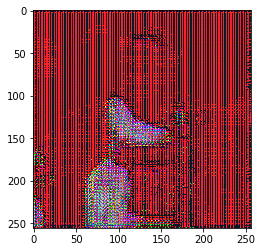

total loss is : 5.222633361816406
style loss is : 4.287203788757324
content loss is : 0.9354297518730164
train pcentage:100/5635
transformerNetwork checkpoint file at models/checkpoint_100.pth


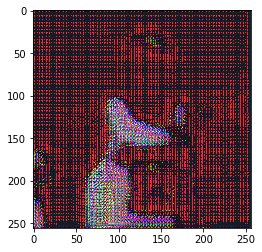

total loss is : 4.2940473556518555
style loss is : 3.576178550720215
content loss is : 0.7178687453269958
train pcentage:150/5635
transformerNetwork checkpoint file at models/checkpoint_150.pth


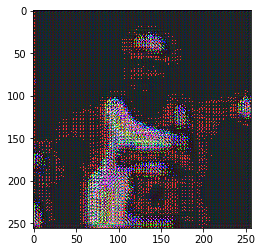

total loss is : 6.069839954376221
style loss is : 5.039626598358154
content loss is : 1.030213475227356
train pcentage:200/5635
transformerNetwork checkpoint file at models/checkpoint_200.pth


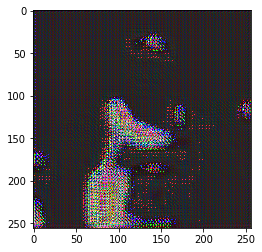

total loss is : 4.767380714416504
style loss is : 3.850677728652954
content loss is : 0.9167031049728394
train pcentage:250/5635
transformerNetwork checkpoint file at models/checkpoint_250.pth


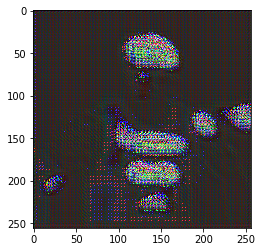

total loss is : 4.283787250518799
style loss is : 3.219257354736328
content loss is : 1.0645298957824707
train pcentage:300/5635
transformerNetwork checkpoint file at models/checkpoint_300.pth


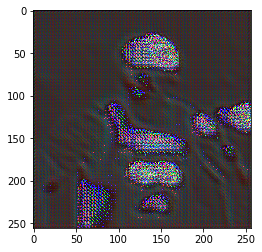

total loss is : 3.9180665016174316
style loss is : 2.7515010833740234
content loss is : 1.1665654182434082
train pcentage:350/5635
transformerNetwork checkpoint file at models/checkpoint_350.pth


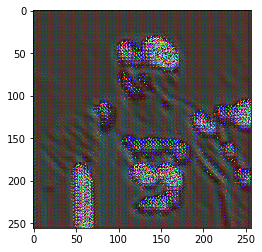

total loss is : 3.376534938812256
style loss is : 2.3956222534179688
content loss is : 0.9809126257896423
train pcentage:400/5635
transformerNetwork checkpoint file at models/checkpoint_400.pth


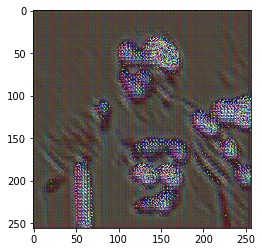

total loss is : 3.482651710510254
style loss is : 2.5005502700805664
content loss is : 0.9821014404296875
train pcentage:450/5635
transformerNetwork checkpoint file at models/checkpoint_450.pth


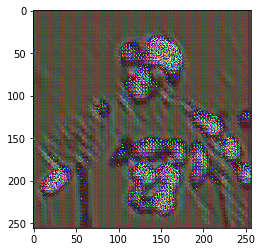

total loss is : 3.4519710540771484
style loss is : 2.142768621444702
content loss is : 1.3092025518417358
train pcentage:500/5635
transformerNetwork checkpoint file at models/checkpoint_500.pth


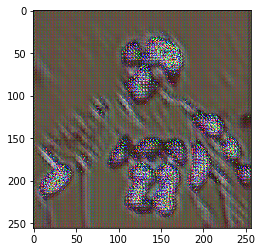

total loss is : 2.833414077758789
style loss is : 1.8076279163360596
content loss is : 1.025786280632019
train pcentage:550/5635
transformerNetwork checkpoint file at models/checkpoint_550.pth


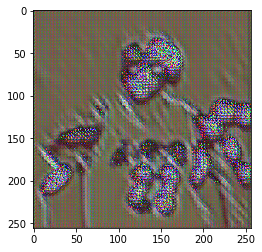

total loss is : 2.9430952072143555
style loss is : 1.6196224689483643
content loss is : 1.3234726190567017
train pcentage:600/5635
transformerNetwork checkpoint file at models/checkpoint_600.pth


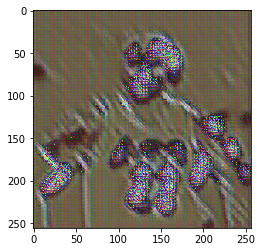

total loss is : 2.8908166885375977
style loss is : 1.7156810760498047
content loss is : 1.1751354932785034
train pcentage:650/5635
transformerNetwork checkpoint file at models/checkpoint_650.pth


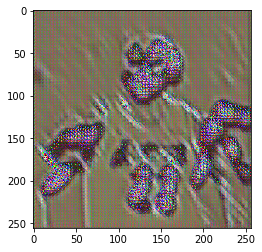

total loss is : 2.601938486099243
style loss is : 1.7518986463546753
content loss is : 0.8500398993492126
train pcentage:700/5635
transformerNetwork checkpoint file at models/checkpoint_700.pth


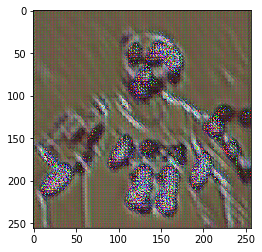

total loss is : 2.8160672187805176
style loss is : 1.6568681001663208
content loss is : 1.1591991186141968
train pcentage:750/5635
transformerNetwork checkpoint file at models/checkpoint_750.pth


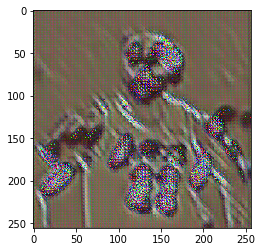

total loss is : 2.369546413421631
style loss is : 1.236527442932129
content loss is : 1.1330190896987915
train pcentage:800/5635
transformerNetwork checkpoint file at models/checkpoint_800.pth


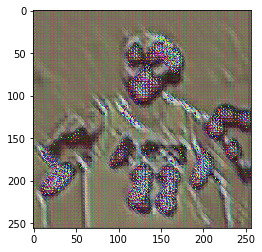

total loss is : 2.422051429748535
style loss is : 1.3362245559692383
content loss is : 1.0858268737792969
train pcentage:850/5635
transformerNetwork checkpoint file at models/checkpoint_850.pth


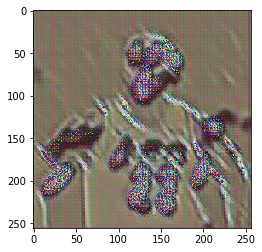

total loss is : 3.2233314514160156
style loss is : 2.0836687088012695
content loss is : 1.139662742614746
train pcentage:900/5635
transformerNetwork checkpoint file at models/checkpoint_900.pth


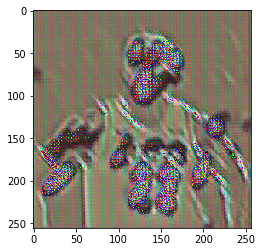

total loss is : 2.7795848846435547
style loss is : 1.5890164375305176
content loss is : 1.1905685663223267
train pcentage:950/5635
transformerNetwork checkpoint file at models/checkpoint_950.pth


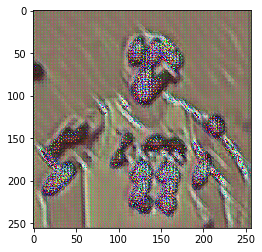

total loss is : 2.4201290607452393
style loss is : 1.3022854328155518
content loss is : 1.1178436279296875
train pcentage:1000/5635
transformerNetwork checkpoint file at models/checkpoint_1000.pth


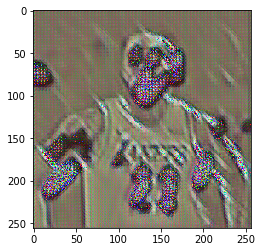

total loss is : 2.389056444168091
style loss is : 1.2911683320999146
content loss is : 1.0978881120681763
train pcentage:1050/5635
transformerNetwork checkpoint file at models/checkpoint_1050.pth


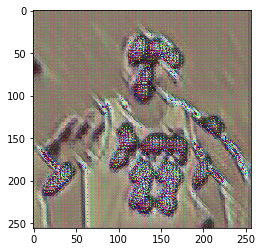

total loss is : 2.991492748260498
style loss is : 1.8436781167984009
content loss is : 1.1478146314620972
train pcentage:1100/5635
transformerNetwork checkpoint file at models/checkpoint_1100.pth


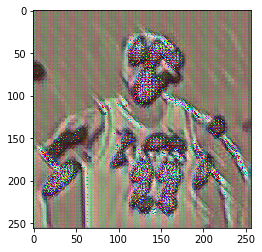

total loss is : 2.5961899757385254
style loss is : 1.4072011709213257
content loss is : 1.1889886856079102
train pcentage:1150/5635
transformerNetwork checkpoint file at models/checkpoint_1150.pth


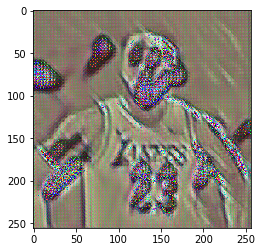

total loss is : 2.052734851837158
style loss is : 1.0122712850570679
content loss is : 1.0404636859893799
train pcentage:1200/5635
transformerNetwork checkpoint file at models/checkpoint_1200.pth


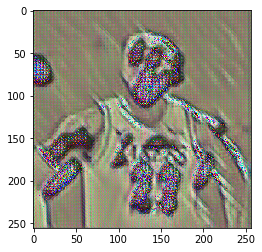

total loss is : 2.2567973136901855
style loss is : 1.086362600326538
content loss is : 1.170434832572937
train pcentage:1250/5635
transformerNetwork checkpoint file at models/checkpoint_1250.pth


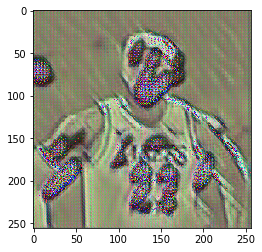

total loss is : 2.4893293380737305
style loss is : 1.4590879678726196
content loss is : 1.0302412509918213
train pcentage:1300/5635
transformerNetwork checkpoint file at models/checkpoint_1300.pth


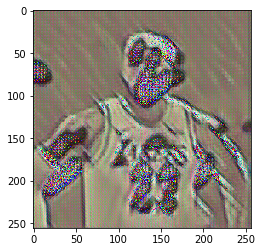

total loss is : 2.1527552604675293
style loss is : 1.0536117553710938
content loss is : 1.099143385887146
train pcentage:1350/5635
transformerNetwork checkpoint file at models/checkpoint_1350.pth


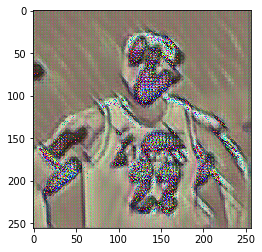

total loss is : 1.8807755708694458
style loss is : 0.9154201745986938
content loss is : 0.965355396270752
train pcentage:1400/5635
transformerNetwork checkpoint file at models/checkpoint_1400.pth


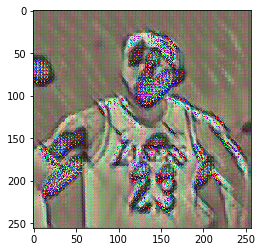

total loss is : 2.139091968536377
style loss is : 1.2828601598739624
content loss is : 0.856231689453125
train pcentage:1450/5635
transformerNetwork checkpoint file at models/checkpoint_1450.pth


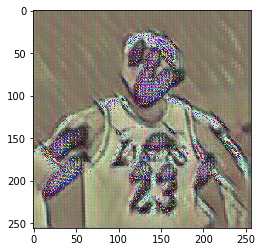

total loss is : 2.3344337940216064
style loss is : 1.3632291555404663
content loss is : 0.9712046384811401
train pcentage:1500/5635
transformerNetwork checkpoint file at models/checkpoint_1500.pth


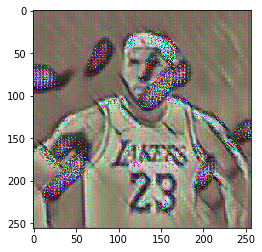

total loss is : 1.8660216331481934
style loss is : 0.9265981912612915
content loss is : 0.9394233822822571
train pcentage:1550/5635
transformerNetwork checkpoint file at models/checkpoint_1550.pth


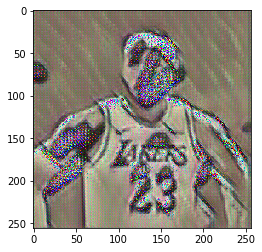

total loss is : 1.9290229082107544
style loss is : 1.0768587589263916
content loss is : 0.8521641492843628
train pcentage:1600/5635
transformerNetwork checkpoint file at models/checkpoint_1600.pth


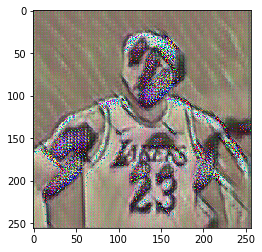

total loss is : 2.569533586502075
style loss is : 1.7184057235717773
content loss is : 0.8511279225349426
train pcentage:1650/5635
transformerNetwork checkpoint file at models/checkpoint_1650.pth


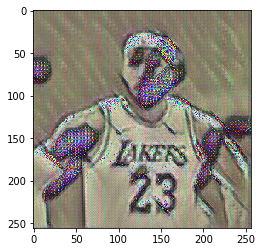

total loss is : 1.9035248756408691
style loss is : 1.1067970991134644
content loss is : 0.79672771692276
train pcentage:1700/5635
transformerNetwork checkpoint file at models/checkpoint_1700.pth


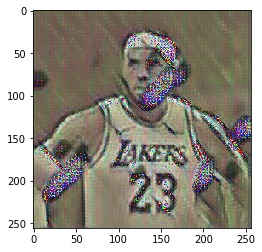

total loss is : 1.702364206314087
style loss is : 0.6988179683685303
content loss is : 1.0035462379455566
train pcentage:1750/5635
transformerNetwork checkpoint file at models/checkpoint_1750.pth


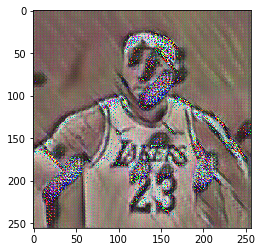

total loss is : 1.9474709033966064
style loss is : 1.1313581466674805
content loss is : 0.8161128163337708
train pcentage:1800/5635
transformerNetwork checkpoint file at models/checkpoint_1800.pth


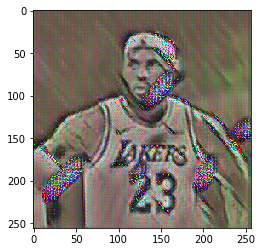

total loss is : 1.6570589542388916
style loss is : 0.6872450113296509
content loss is : 0.9698139429092407
train pcentage:1850/5635
transformerNetwork checkpoint file at models/checkpoint_1850.pth


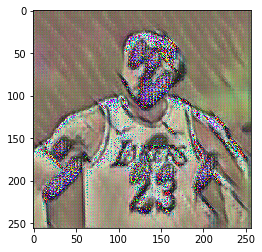

total loss is : 1.9227845668792725
style loss is : 1.0729520320892334
content loss is : 0.8498325943946838
train pcentage:1900/5635
transformerNetwork checkpoint file at models/checkpoint_1900.pth


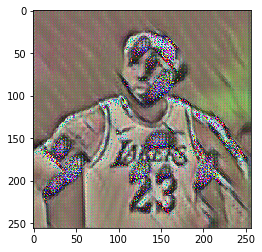

total loss is : 2.0324900150299072
style loss is : 1.072075366973877
content loss is : 0.9604146480560303
train pcentage:1950/5635
transformerNetwork checkpoint file at models/checkpoint_1950.pth


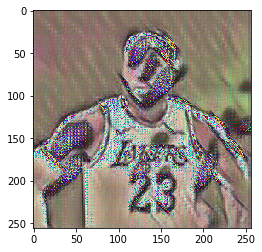

total loss is : 2.0759706497192383
style loss is : 1.0795130729675293
content loss is : 0.9964576363563538
train pcentage:2000/5635
transformerNetwork checkpoint file at models/checkpoint_2000.pth


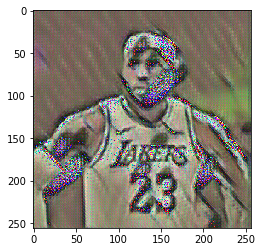

total loss is : 1.8865537643432617
style loss is : 0.9807393550872803
content loss is : 0.9058144092559814
train pcentage:2050/5635
transformerNetwork checkpoint file at models/checkpoint_2050.pth


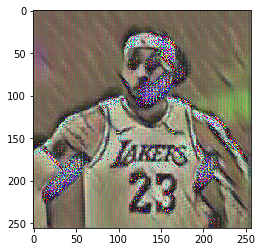

total loss is : 1.8482437133789062
style loss is : 0.9098079204559326
content loss is : 0.9384357333183289
train pcentage:2100/5635
transformerNetwork checkpoint file at models/checkpoint_2100.pth


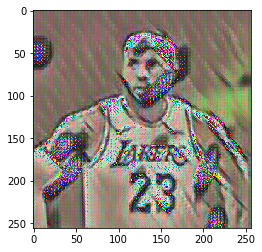

total loss is : 1.5384525060653687
style loss is : 0.7764064073562622
content loss is : 0.7620460987091064
train pcentage:2150/5635
transformerNetwork checkpoint file at models/checkpoint_2150.pth


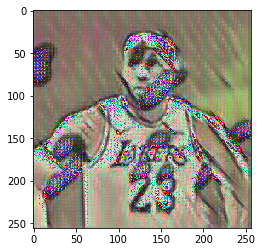

total loss is : 1.7650890350341797
style loss is : 0.946095883846283
content loss is : 0.8189932107925415
train pcentage:2200/5635
transformerNetwork checkpoint file at models/checkpoint_2200.pth


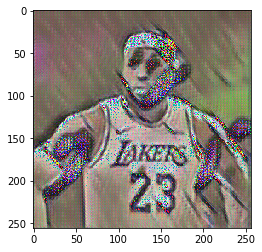

total loss is : 2.022587299346924
style loss is : 1.1137934923171997
content loss is : 0.9087938070297241
train pcentage:2250/5635
transformerNetwork checkpoint file at models/checkpoint_2250.pth


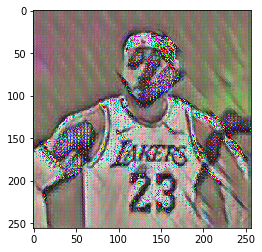

total loss is : 1.9837559461593628
style loss is : 1.023032784461975
content loss is : 0.9607231616973877
train pcentage:2300/5635
transformerNetwork checkpoint file at models/checkpoint_2300.pth


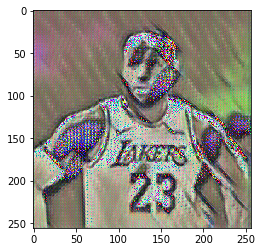

total loss is : 1.9698494672775269
style loss is : 1.232058048248291
content loss is : 0.7377914190292358
train pcentage:2350/5635
transformerNetwork checkpoint file at models/checkpoint_2350.pth


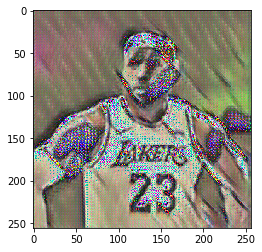

total loss is : 2.5010643005371094
style loss is : 1.4869961738586426
content loss is : 1.0140680074691772
train pcentage:2400/5635
transformerNetwork checkpoint file at models/checkpoint_2400.pth


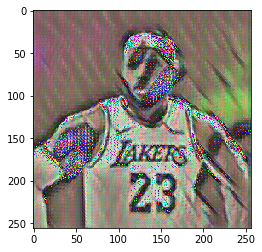

total loss is : 1.5347751379013062
style loss is : 0.7415117025375366
content loss is : 0.7932634353637695
train pcentage:2450/5635
transformerNetwork checkpoint file at models/checkpoint_2450.pth


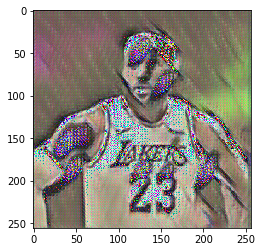

total loss is : 1.540449857711792
style loss is : 0.7167537212371826
content loss is : 0.8236961364746094
train pcentage:2500/5635
transformerNetwork checkpoint file at models/checkpoint_2500.pth


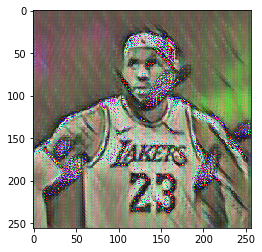

total loss is : 1.5946176052093506
style loss is : 0.6993559002876282
content loss is : 0.8952617645263672
train pcentage:2550/5635
transformerNetwork checkpoint file at models/checkpoint_2550.pth


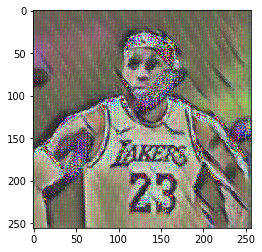

total loss is : 1.5108733177185059
style loss is : 0.7179094552993774
content loss is : 0.7929639220237732
train pcentage:2600/5635
transformerNetwork checkpoint file at models/checkpoint_2600.pth


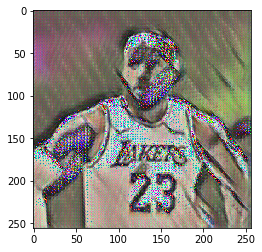

total loss is : 1.9146831035614014
style loss is : 1.0884007215499878
content loss is : 0.8262824416160583
train pcentage:2650/5635
transformerNetwork checkpoint file at models/checkpoint_2650.pth


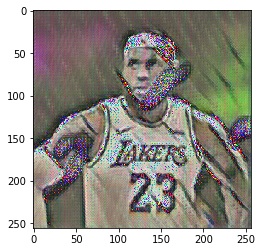

total loss is : 1.511923909187317
style loss is : 0.8238942623138428
content loss is : 0.6880296468734741
train pcentage:2700/5635
transformerNetwork checkpoint file at models/checkpoint_2700.pth


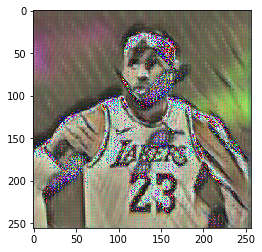

total loss is : 1.8132888078689575
style loss is : 0.9279288649559021
content loss is : 0.8853599429130554
train pcentage:2750/5635
transformerNetwork checkpoint file at models/checkpoint_2750.pth


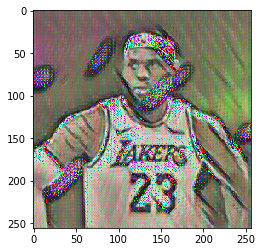

total loss is : 1.8180034160614014
style loss is : 0.9692087173461914
content loss is : 0.8487946391105652
train pcentage:2800/5635
transformerNetwork checkpoint file at models/checkpoint_2800.pth


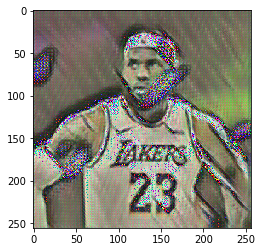

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:72: ComplexWarning: Casting complex values to real discards the imaginary part


total loss is : 1.9642255306243896
style loss is : 1.0340925455093384
content loss is : 0.9301329851150513
train pcentage:2850/5635
transformerNetwork checkpoint file at models/checkpoint_2850.pth


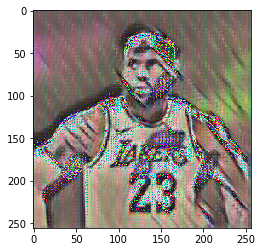

total loss is : 1.942152738571167
style loss is : 1.194140911102295
content loss is : 0.7480118274688721
train pcentage:2900/5635
transformerNetwork checkpoint file at models/checkpoint_2900.pth


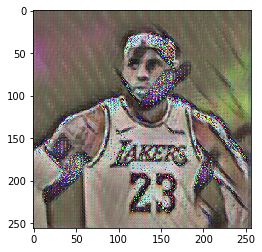

total loss is : 1.8461644649505615
style loss is : 1.050705075263977
content loss is : 0.7954593896865845
train pcentage:2950/5635
transformerNetwork checkpoint file at models/checkpoint_2950.pth


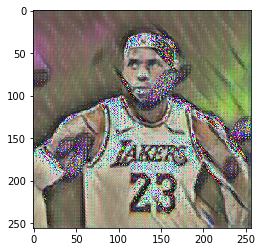

total loss is : 1.7768847942352295
style loss is : 0.9932191371917725
content loss is : 0.7836655974388123
train pcentage:3000/5635
transformerNetwork checkpoint file at models/checkpoint_3000.pth


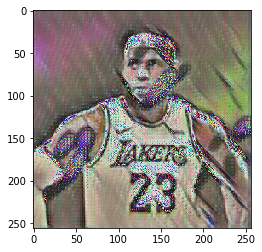

total loss is : 1.7468304634094238
style loss is : 0.9145112633705139
content loss is : 0.8323192596435547
train pcentage:3050/5635
transformerNetwork checkpoint file at models/checkpoint_3050.pth


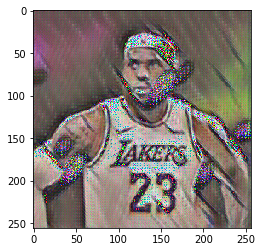

total loss is : 1.4503023624420166
style loss is : 0.75005704164505
content loss is : 0.7002453804016113
train pcentage:3100/5635
transformerNetwork checkpoint file at models/checkpoint_3100.pth


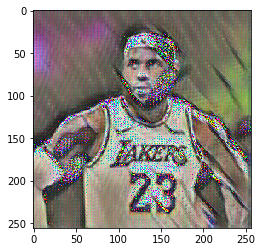

total loss is : 1.6162183284759521
style loss is : 0.7619404792785645
content loss is : 0.8542779088020325
train pcentage:3150/5635
transformerNetwork checkpoint file at models/checkpoint_3150.pth


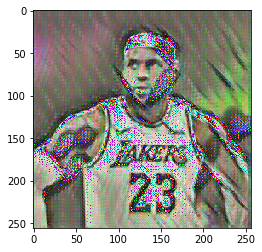

total loss is : 2.310171604156494
style loss is : 1.5275424718856812
content loss is : 0.7826290726661682
train pcentage:3200/5635
transformerNetwork checkpoint file at models/checkpoint_3200.pth


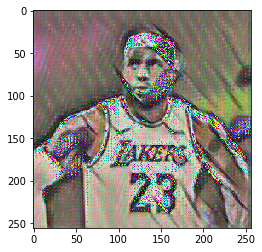

total loss is : 1.577654480934143
style loss is : 0.9969707131385803
content loss is : 0.5806837677955627
train pcentage:3250/5635
transformerNetwork checkpoint file at models/checkpoint_3250.pth


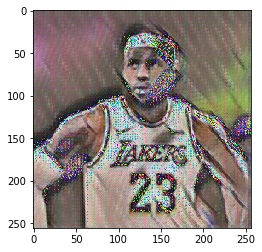

total loss is : 1.5774606466293335
style loss is : 0.8208751678466797
content loss is : 0.7565854787826538
train pcentage:3300/5635
transformerNetwork checkpoint file at models/checkpoint_3300.pth


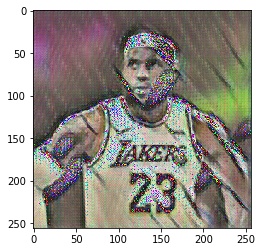

total loss is : 1.4268438816070557
style loss is : 0.7604790925979614
content loss is : 0.6663647890090942
train pcentage:3350/5635
transformerNetwork checkpoint file at models/checkpoint_3350.pth


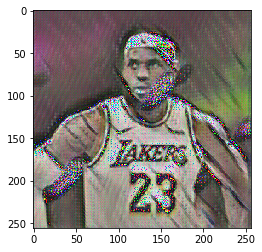

total loss is : 2.178847074508667
style loss is : 1.3582357168197632
content loss is : 0.8206113576889038
train pcentage:3400/5635
transformerNetwork checkpoint file at models/checkpoint_3400.pth


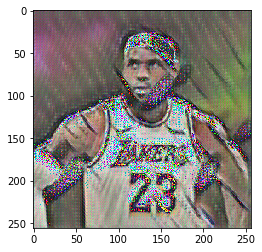

total loss is : 1.7218592166900635
style loss is : 0.9149274230003357
content loss is : 0.8069318532943726
train pcentage:3450/5635
transformerNetwork checkpoint file at models/checkpoint_3450.pth


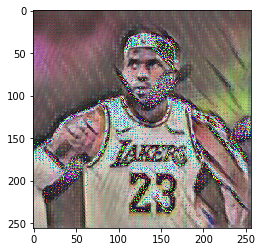

total loss is : 1.518761157989502
style loss is : 0.7032818794250488
content loss is : 0.8154792785644531
train pcentage:3500/5635
transformerNetwork checkpoint file at models/checkpoint_3500.pth


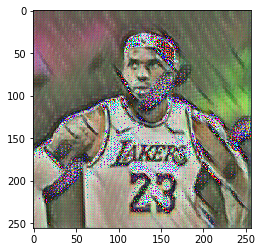

total loss is : 1.3126060962677002
style loss is : 0.6159608960151672
content loss is : 0.6966451406478882
train pcentage:3550/5635
transformerNetwork checkpoint file at models/checkpoint_3550.pth


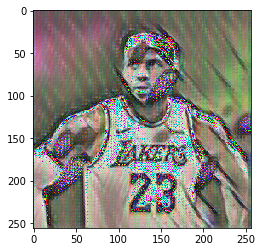

total loss is : 1.3140852451324463
style loss is : 0.6234931349754333
content loss is : 0.6905921101570129
train pcentage:3600/5635
transformerNetwork checkpoint file at models/checkpoint_3600.pth


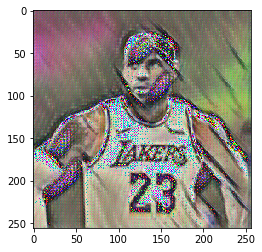

total loss is : 1.5110580921173096
style loss is : 0.7623723745346069
content loss is : 0.7486857771873474
train pcentage:3650/5635
transformerNetwork checkpoint file at models/checkpoint_3650.pth


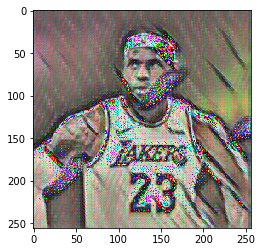

total loss is : 1.7059266567230225
style loss is : 0.8855394124984741
content loss is : 0.8203873038291931
train pcentage:3700/5635
transformerNetwork checkpoint file at models/checkpoint_3700.pth


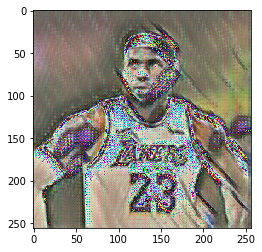

total loss is : 2.242279529571533
style loss is : 1.4950950145721436
content loss is : 0.7471843957901001
train pcentage:3750/5635
transformerNetwork checkpoint file at models/checkpoint_3750.pth


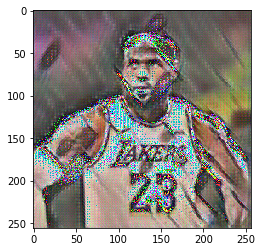

total loss is : 1.343885898590088
style loss is : 0.6584492921829224
content loss is : 0.6854365468025208
train pcentage:3800/5635
transformerNetwork checkpoint file at models/checkpoint_3800.pth


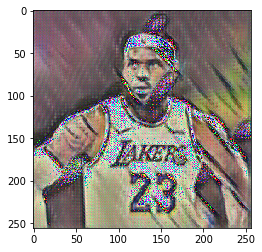

total loss is : 2.0840272903442383
style loss is : 1.307974100112915
content loss is : 0.776053249835968
train pcentage:3850/5635
transformerNetwork checkpoint file at models/checkpoint_3850.pth


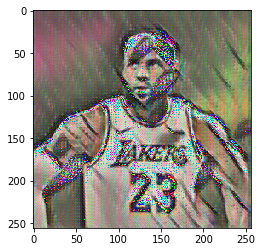

total loss is : 1.4817404747009277
style loss is : 0.814025342464447
content loss is : 0.6677151322364807
train pcentage:3900/5635
transformerNetwork checkpoint file at models/checkpoint_3900.pth


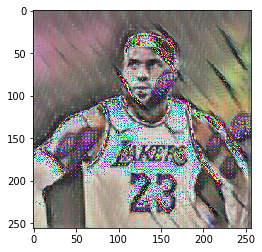

total loss is : 1.931485891342163
style loss is : 1.2440325021743774
content loss is : 0.6874533891677856
train pcentage:3950/5635
transformerNetwork checkpoint file at models/checkpoint_3950.pth


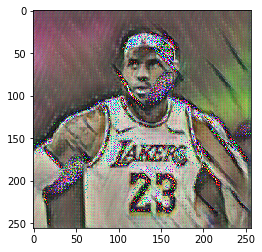

total loss is : 1.5796515941619873
style loss is : 0.886384904384613
content loss is : 0.6932666301727295
train pcentage:4000/5635
transformerNetwork checkpoint file at models/checkpoint_4000.pth


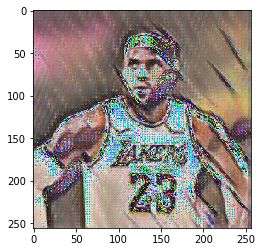

total loss is : 1.4942190647125244
style loss is : 0.8112900257110596
content loss is : 0.6829289793968201
train pcentage:4050/5635
transformerNetwork checkpoint file at models/checkpoint_4050.pth


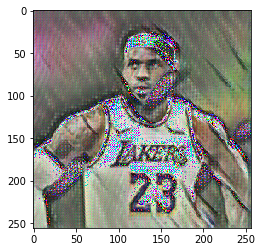

total loss is : 1.6986079216003418
style loss is : 1.0196990966796875
content loss is : 0.6789087653160095
train pcentage:4100/5635
transformerNetwork checkpoint file at models/checkpoint_4100.pth


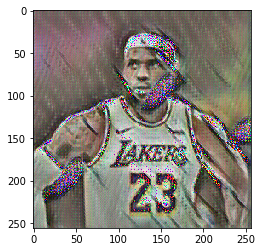

total loss is : 1.624946117401123
style loss is : 0.9364890456199646
content loss is : 0.6884571313858032
train pcentage:4150/5635
transformerNetwork checkpoint file at models/checkpoint_4150.pth


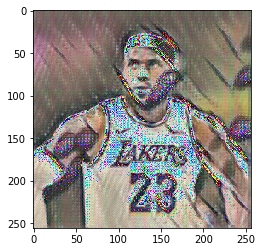

total loss is : 1.4957647323608398
style loss is : 0.8805115818977356
content loss is : 0.6152531504631042
train pcentage:4200/5635
transformerNetwork checkpoint file at models/checkpoint_4200.pth


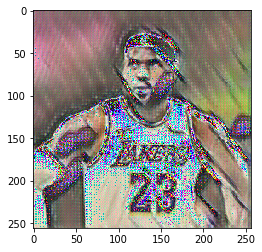

total loss is : 1.779024362564087
style loss is : 1.0946842432022095
content loss is : 0.6843401789665222
train pcentage:4250/5635
transformerNetwork checkpoint file at models/checkpoint_4250.pth


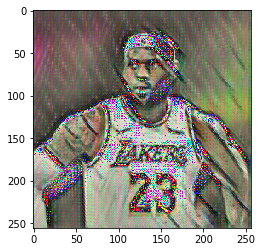

total loss is : 1.6502081155776978
style loss is : 0.9621819257736206
content loss is : 0.6880261898040771
train pcentage:4300/5635
transformerNetwork checkpoint file at models/checkpoint_4300.pth


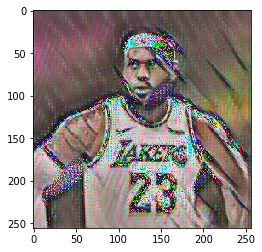

total loss is : 1.5097787380218506
style loss is : 0.7261536717414856
content loss is : 0.7836250066757202
train pcentage:4350/5635
transformerNetwork checkpoint file at models/checkpoint_4350.pth


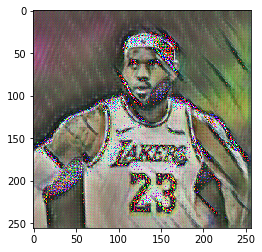

total loss is : 1.7395403385162354
style loss is : 1.1077280044555664
content loss is : 0.6318123936653137
train pcentage:4400/5635
transformerNetwork checkpoint file at models/checkpoint_4400.pth


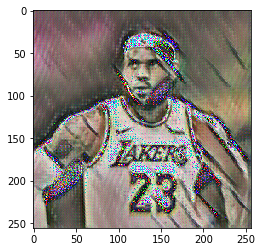

total loss is : 1.4911609888076782
style loss is : 0.807541012763977
content loss is : 0.6836199760437012
train pcentage:4450/5635
transformerNetwork checkpoint file at models/checkpoint_4450.pth


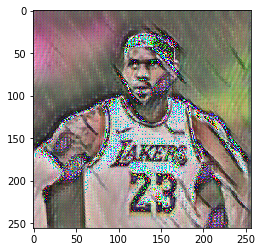

total loss is : 2.2056961059570312
style loss is : 1.5810168981552124
content loss is : 0.6246792078018188
train pcentage:4500/5635
transformerNetwork checkpoint file at models/checkpoint_4500.pth


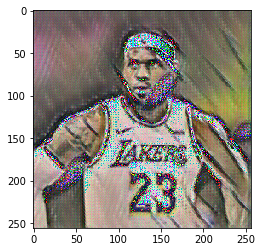

total loss is : 1.3584907054901123
style loss is : 0.5685022473335266
content loss is : 0.7899884581565857
train pcentage:4550/5635
transformerNetwork checkpoint file at models/checkpoint_4550.pth


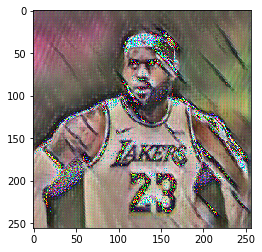

total loss is : 1.6811022758483887
style loss is : 0.9319220781326294
content loss is : 0.7491801381111145
train pcentage:4600/5635
transformerNetwork checkpoint file at models/checkpoint_4600.pth


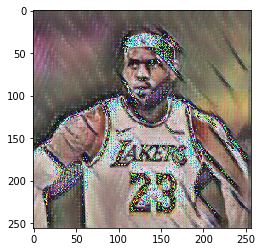

total loss is : 1.3888862133026123
style loss is : 0.7022420167922974
content loss is : 0.6866442561149597
train pcentage:4650/5635
transformerNetwork checkpoint file at models/checkpoint_4650.pth


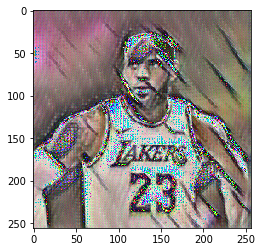

total loss is : 1.9569042921066284
style loss is : 1.3148735761642456
content loss is : 0.6420307159423828
train pcentage:4700/5635
transformerNetwork checkpoint file at models/checkpoint_4700.pth


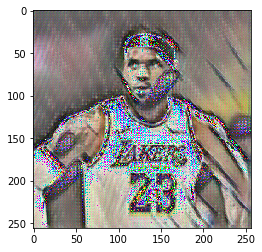

total loss is : 1.3732292652130127
style loss is : 0.7199695706367493
content loss is : 0.6532597541809082
train pcentage:4750/5635
transformerNetwork checkpoint file at models/checkpoint_4750.pth


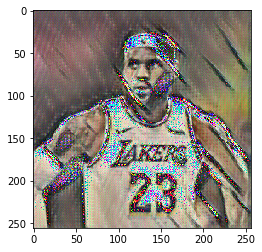

total loss is : 1.660327434539795
style loss is : 1.1362041234970093
content loss is : 0.5241233110427856
train pcentage:4800/5635
transformerNetwork checkpoint file at models/checkpoint_4800.pth


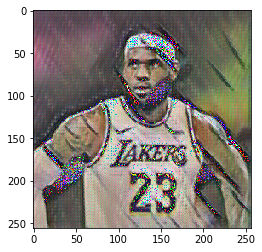

total loss is : 1.5508472919464111
style loss is : 0.8172834515571594
content loss is : 0.7335638999938965
train pcentage:4850/5635
transformerNetwork checkpoint file at models/checkpoint_4850.pth


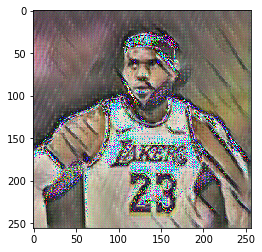

total loss is : 1.3251044750213623
style loss is : 0.6367090344429016
content loss is : 0.6883955001831055
train pcentage:4900/5635
transformerNetwork checkpoint file at models/checkpoint_4900.pth


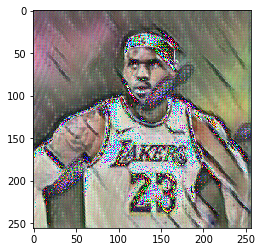

total loss is : 1.6820313930511475
style loss is : 0.8917427659034729
content loss is : 0.7902885675430298
train pcentage:4950/5635
transformerNetwork checkpoint file at models/checkpoint_4950.pth


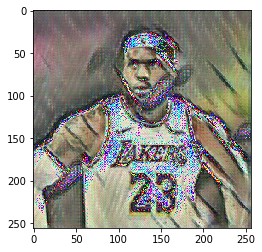

total loss is : 1.4036320447921753
style loss is : 0.7377074956893921
content loss is : 0.6659245491027832
train pcentage:5000/5635
transformerNetwork checkpoint file at models/checkpoint_5000.pth


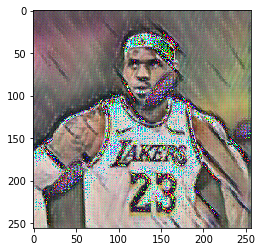

total loss is : 1.756062388420105
style loss is : 1.138904094696045
content loss is : 0.6171582937240601
train pcentage:5050/5635
transformerNetwork checkpoint file at models/checkpoint_5050.pth


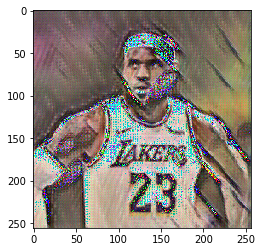

total loss is : 1.3671166896820068
style loss is : 0.7030442357063293
content loss is : 0.6640723943710327
train pcentage:5100/5635
transformerNetwork checkpoint file at models/checkpoint_5100.pth


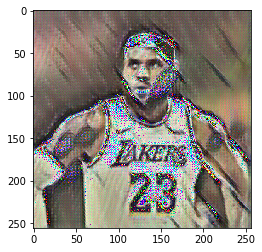

total loss is : 1.5057345628738403
style loss is : 0.9063143730163574
content loss is : 0.5994201898574829
train pcentage:5150/5635
transformerNetwork checkpoint file at models/checkpoint_5150.pth


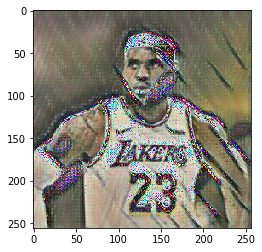

total loss is : 1.3520926237106323
style loss is : 0.6377547383308411
content loss is : 0.7143378853797913
train pcentage:5200/5635
transformerNetwork checkpoint file at models/checkpoint_5200.pth


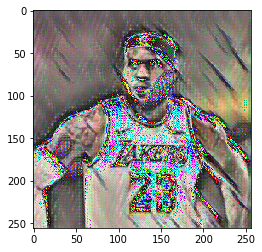

total loss is : 1.3242703676223755
style loss is : 0.7218148112297058
content loss is : 0.6024555563926697
train pcentage:5250/5635
transformerNetwork checkpoint file at models/checkpoint_5250.pth


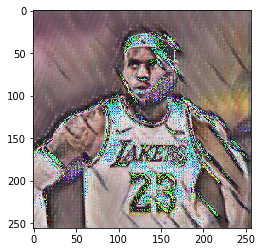

total loss is : 1.4363243579864502
style loss is : 0.7477909326553345
content loss is : 0.6885334253311157
train pcentage:5300/5635
transformerNetwork checkpoint file at models/checkpoint_5300.pth


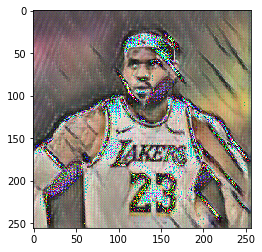

total loss is : 2.195371389389038
style loss is : 1.4942857027053833
content loss is : 0.7010857462882996
train pcentage:5350/5635
transformerNetwork checkpoint file at models/checkpoint_5350.pth


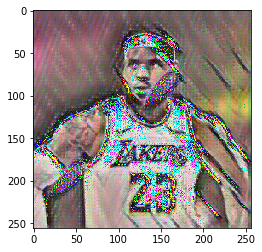

total loss is : 1.5476891994476318
style loss is : 0.8570877313613892
content loss is : 0.6906014680862427
train pcentage:5400/5635
transformerNetwork checkpoint file at models/checkpoint_5400.pth


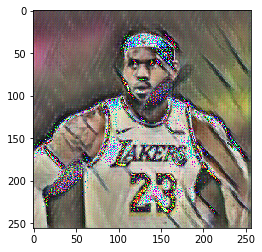

total loss is : 1.2543973922729492
style loss is : 0.5777890682220459
content loss is : 0.6766083240509033
train pcentage:5450/5635
transformerNetwork checkpoint file at models/checkpoint_5450.pth


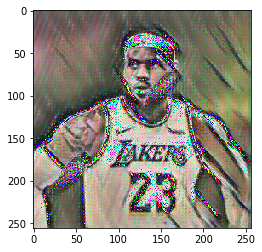

total loss is : 1.2031211853027344
style loss is : 0.7020257711410522
content loss is : 0.5010954737663269
train pcentage:5500/5635
transformerNetwork checkpoint file at models/checkpoint_5500.pth


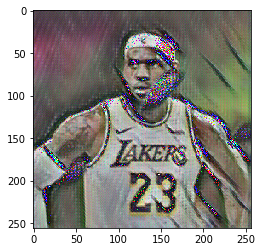

total loss is : 1.6641242504119873
style loss is : 1.0710195302963257
content loss is : 0.5931047797203064
train pcentage:5550/5635
transformerNetwork checkpoint file at models/checkpoint_5550.pth


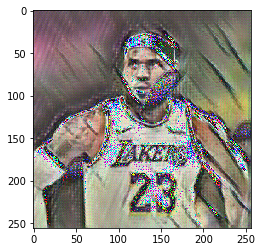

total loss is : 1.441225528717041
style loss is : 0.8119673728942871
content loss is : 0.6292581558227539
train pcentage:5600/5635
transformerNetwork checkpoint file at models/checkpoint_5600.pth


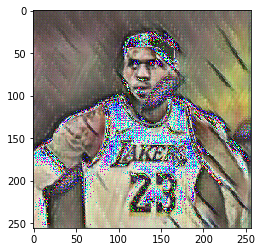

Saving TransformerNetwork weights at models/transformer_weight.pth
Done saving final model


In [0]:
dataset_path = "dataset"
model_path = "saved_models/"
image_path = "stored_image/out/"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
cnn = models.vgg19(pretrained=True).features.to(device).eval()

image_transformer = transforms.Compose([                           
transforms.Resize(256),  
transforms.CenterCrop(256),
transforms.ToTensor()])  

image_transformer2 = transforms.Compose([                              
transforms.ToPILImage(),                                                       
transforms.Resize(256),  
transforms.CenterCrop(256),
transforms.ToTensor()])  

def image_show(tensor, title=None):
    image_untransformer = transforms.ToPILImage()
    image = tensor.cpu().clone() 
    image = image.squeeze(0)     
    image = image_untransformer(image)
    plt.imshow(image)
    if title is not None:
        plt.title(title)
    plt.pause(0.02) 

def image_loader(image_name):
    image = Image.open(image_name)
    image = image_transformer(image).unsqueeze(0)
    return image.to(device, torch.float)

style_img = image_loader("stored_image/picasso2.jpg")
style_img_copy = style_img.clone()
check_img = image_loader("stored_image/lebron2.jpg")



import six
# solve the python2 v.s. python 3 problem
import numpy as np
# import the math tool for matrix

def color_transfer(style_img, content_img):
    output_style = np.zeros_like(style_img)
    ds_size = style_img[0].shape
    for item in six.moves.range(len(style_img)):
        #reshaope
        reshape_style = style_img[item].reshape((3, -1))
        reshape_content = content_img[item].reshape((3, -1))
        #mean
        reshape_style_mean = np.mean(reshape_style,keepdims=True,axis=1)
        reshape_content_mean = np.mean(reshape_content,keepdims=True,axis=1)
        #covariance
        reshape_style_covariance = np.cov(reshape_style)
        reshape_content_covariance = np.cov(reshape_content)

        # inv_sigmoid
        weight, vector = np.linalg.eig(reshape_style_covariance)
        weight = weight + 1e-6
        temp1 = np.diag(weight**(-0.5))
        reshape_style_inv = vector.dot(temp1).dot(vector.T)

        #sigmoid
        weight, vector = np.linalg.eig( reshape_content_covariance)
        temp2 =np.diag(weight**0.5)
        reshape_content_sig = vector.dot(temp2).dot(vector.T)

        dot_s_c = reshape_content_sig.dot(reshape_style_inv)
        temp = dot_s_c.dot(reshape_style - reshape_style_mean) + reshape_content_mean
        #reshape back to original one
        output_style[item,:] = temp.reshape(ds_size)
    return output_style


# extend image with batch size
a, b, c, d = style_img.shape
style_img_copy = style_img_copy.expand(8, b, c, d)

def train_transformer(cnn, style_img, style_weight=15000000, content_weight=1):

    # prepare dataloader
    train_dataset = datasets.ImageFolder(dataset_path, transform=image_transformer)
    train_loader = torch.utils.data.DataLoader(train_dataset, batch_size = 8, shuffle=True)

    # Optimizer settings

    print('Training the style transfer model..')
    print("Using Adams as optimizer")
    transformerNetwork = TransformerNetwork().to(device)

    # load exsit data
    # transformerNetwork.load_state_dict(torch.load("saved_models/checkpoint_1400.pth"))
    optimizer = optim.Adam(transformerNetwork.parameters())
    print('Start Optimization')
    count = 0
    print("length of train_loader {}".format(len(train_loader)))
    for input_img, i in train_loader:
          style_img = style_img_copy.clone()
          # keep color
          np_c = input_img.cpu().numpy()
          np_s = style_img.cpu().numpy()
          # try:
          g = color_transfer(np_s,np_c)
          # except np.linalg.LinAlgError:
          #     print('error')
          #     continue
          style_img = torch.from_numpy(g)
          style_img = style_img.to(device)
          optimizer.zero_grad()
          torch.cuda.empty_cache()

          # Load networks and generate transformed pictures
          transformed_img = transformerNetwork(input_img.to(device))

          # get style loss and content loss
          model_VGG, style_losses, content_losses = get_model(cnn, style_img, input_img.to(device))
          model_VGG(transformed_img)

          # Using the sum of style_loss.loss to caculate the style loss score 
          style_loss_score=[style_loss.loss for style_loss in style_losses]

          # Using the sum of content_loss.loss to caculate the content_loss score 
          content_loss_score=[content_loss.loss for content_loss in content_losses]
          style_loss_score=torch.stack(style_loss_score).sum()
          content_loss_score=torch.stack(content_loss_score).sum()

          # using the weight of style loss and content loss to caculate the total loss
          loss = style_weight*style_loss_score + content_weight*content_loss_score
          loss.backward()
          optimizer.step()
          count +=1

          # track loss
          if (count % 50 == 0):
              print("total loss is : {}".format(loss))
              print("style loss is : {}".format(style_weight*style_loss_score))
              print("content loss is : {}".format(content_weight*content_loss_score))
              print("train pcentage:{}/{}".format(count, len(train_loader)))

              # Save Model
              checkpoint_path = "saved_models/" + "checkpoint_" + str(count) + ".pth"
              torch.save(transformerNetwork.state_dict(), checkpoint_path)
              print("transformerNetwork checkpoint file at {}".format(checkpoint_path))   

              # check the effect of transformer
              transformed_check_img = transformerNetwork(check_img)
              plt.figure
              image_show(transformed_check_img)

    
    # Save 
    transformerNetwork.eval()
    transformerNetwork.cpu()
    final_path = model_path + "transformer_weight.pth"
    torch.save(transformerNetwork.state_dict(), final_path)
  

train_transformer(cnn, style_img)